In [1]:
import pandas as pd
import numpy as np
import os
import pickle
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn import __version__ as sklearn_version
from sklearn.decomposition import PCA
from sklearn.preprocessing import scale
from sklearn.model_selection import train_test_split, cross_validate, GridSearchCV, learning_curve
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.dummy import DummyRegressor
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from sklearn.pipeline import make_pipeline
from sklearn.impute import SimpleImputer
from sklearn.feature_selection import SelectKBest, f_regression
import datetime
import sys
import numpy
numpy.set_printoptions(threshold=sys.maxsize)

In [2]:
data = pd.read_csv("credit_train.csv")

In [3]:
data.head()

,Loan ID,Customer ID,Loan Status,Current Loan Amount,Term,Credit Score,Annual Income,Years in current job,Home Ownership,Purpose,Monthly Debt,Years of Credit History,Months since last delinquent,Number of Open Accounts,Number of Credit Problems,Current Credit Balance,Maximum Open Credit,Bankruptcies,Tax Liens
0,14dd8831-6af5-400b-83ec-68e61888a048,981165ec-3274-42f5-a3b4-d104041a9ca9,Fully Paid,445412.0,Short Term,709.0,1167493.0,8 years,Home Mortgage,Home Improvements,5214.74,17.2,NaN,6.0,1.0,228190.0,416746.0,1.0,0.0
1,4771cc26-131a-45db-b5aa-537ea4ba5342,2de017a3-2e01-49cb-a581-08169e83be29,Fully Paid,262328.0,Short Term,NaN,NaN,10+ years,Home Mortgage,Debt Consolidation,33295.98,21.1,8.0,35.0,0.0,229976.0,850784.0,0.0,0.0
2,4eed4e6a-aa2f-4c91-8651-ce984ee8fb26,5efb2b2b-bf11-4dfd-a572-3761a2694725,Fully Paid,99999999.0,Short Term,741.0,2231892.0,8 years,Own Home,Debt Consolidation,29200.53,14.9,29.0,18.0,1.0,297996.0,750090.0,0.0,0.0
3,77598f7b-32e7-4e3b-a6e5-06ba0d98fe8a,e777faab-98ae-45af-9a86-7ce5b33b1011,Fully Paid,347666.0,Long Term,721.0,806949.0,3 years,Own Home,Debt Consolidation,8741.90,12.0,NaN,9.0,0.0,256329.0,386958.0,0.0,0.0
4,d4062e70-befa-4995-8643-a0de73938182,81536ad9-5ccf-4eb8-befb-47a4d608658e,Fully Paid,176220.0,Short Term,NaN,NaN,5 years,Rent,Debt Consolidation,20639.70,6.1,NaN,15.0,0.0,253460.0,427174.0,0.0,0.0


In [4]:
data.columns = data.columns.str.replace(' ', '') #Removing white space so it would be easier to execute code 

In [5]:
data.head() #Checking if the white space is removed or not

,LoanID,CustomerID,LoanStatus,CurrentLoanAmount,Term,CreditScore,AnnualIncome,Yearsincurrentjob,HomeOwnership,Purpose,MonthlyDebt,YearsofCreditHistory,Monthssincelastdelinquent,NumberofOpenAccounts,NumberofCreditProblems,CurrentCreditBalance,MaximumOpenCredit,Bankruptcies,TaxLiens
0,14dd8831-6af5-400b-83ec-68e61888a048,981165ec-3274-42f5-a3b4-d104041a9ca9,Fully Paid,445412.0,Short Term,709.0,1167493.0,8 years,Home Mortgage,Home Improvements,5214.74,17.2,NaN,6.0,1.0,228190.0,416746.0,1.0,0.0
1,4771cc26-131a-45db-b5aa-537ea4ba5342,2de017a3-2e01-49cb-a581-08169e83be29,Fully Paid,262328.0,Short Term,NaN,NaN,10+ years,Home Mortgage,Debt Consolidation,33295.98,21.1,8.0,35.0,0.0,229976.0,850784.0,0.0,0.0
2,4eed4e6a-aa2f-4c91-8651-ce984ee8fb26,5efb2b2b-bf11-4dfd-a572-3761a2694725,Fully Paid,99999999.0,Short Term,741.0,2231892.0,8 years,Own Home,Debt Consolidation,29200.53,14.9,29.0,18.0,1.0,297996.0,750090.0,0.0,0.0
3,77598f7b-32e7-4e3b-a6e5-06ba0d98fe8a,e777faab-98ae-45af-9a86-7ce5b33b1011,Fully Paid,347666.0,Long Term,721.0,806949.0,3 years,Own Home,Debt Consolidation,8741.90,12.0,NaN,9.0,0.0,256329.0,386958.0,0.0,0.0
4,d4062e70-befa-4995-8643-a0de73938182,81536ad9-5ccf-4eb8-befb-47a4d608658e,Fully Paid,176220.0,Short Term,NaN,NaN,5 years,Rent,Debt Consolidation,20639.70,6.1,NaN,15.0,0.0,253460.0,427174.0,0.0,0.0


In [6]:
data.shape

(100514, 19)

In [7]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100514 entries, 0 to 100513
Data columns (total 19 columns):
 #   Column                     Non-Null Count   Dtype  
---  ------                     --------------   -----  
 0   LoanID                     100000 non-null  object 
 1   CustomerID                 100000 non-null  object 
 2   LoanStatus                 100000 non-null  object 
 3   CurrentLoanAmount          100000 non-null  float64
 4   Term                       100000 non-null  object 
 5   CreditScore                80846 non-null   float64
 6   AnnualIncome               80846 non-null   float64
 7   Yearsincurrentjob          95778 non-null   object 
 8   HomeOwnership              100000 non-null  object 
 9   Purpose                    100000 non-null  object 
 10  MonthlyDebt                100000 non-null  float64
 11  YearsofCreditHistory       100000 non-null  float64
 12  Monthssincelastdelinquent  46859 non-null   float64
 13  NumberofOpenAccounts       10

In [8]:
data.describe()

,CurrentLoanAmount,CreditScore,AnnualIncome,MonthlyDebt,YearsofCreditHistory,Monthssincelastdelinquent,NumberofOpenAccounts,NumberofCreditProblems,CurrentCreditBalance,MaximumOpenCredit,Bankruptcies,TaxLiens
count,1.000000e+05,80846.000000,8.084600e+04,100000.000000,100000.000000,46859.000000,100000.00000,100000.000000,1.000000e+05,9.999800e+04,99796.000000,99990.000000
mean,1.176045e+07,1076.456089,1.378277e+06,18472.412336,18.199141,34.901321,11.12853,0.168310,2.946374e+05,7.607984e+05,0.117740,0.029313
std,3.178394e+07,1475.403791,1.081360e+06,12174.992609,7.015324,21.997829,5.00987,0.482705,3.761709e+05,8.384503e+06,0.351424,0.258182
min,1.080200e+04,585.000000,7.662700e+04,0.000000,3.600000,0.000000,0.00000,0.000000,0.000000e+00,0.000000e+00,0.000000,0.000000
25%,1.796520e+05,705.000000,8.488440e+05,10214.162500,13.500000,16.000000,8.00000,0.000000,1.126700e+05,2.734380e+05,0.000000,0.000000
50%,3.122460e+05,724.000000,1.174162e+06,16220.300000,16.900000,32.000000,10.00000,0.000000,2.098170e+05,4.678740e+05,0.000000,0.000000
75%,5.249420e+05,741.000000,1.650663e+06,24012.057500,21.700000,51.000000,14.00000,0.000000,3.679588e+05,7.829580e+05,0.000000,0.000000
max,1.000000e+08,7510.000000,1.655574e+08,435843.280000,70.500000,176.000000,76.00000,15.000000,3.287897e+07,1.539738e+09,7.000000,15.000000


In [9]:
print(data["CreditScore"])

0         709.0
1           NaN
2         741.0
3         721.0
4           NaN
          ...  
100509      NaN
100510      NaN
100511      NaN
100512      NaN
100513      NaN
Name: CreditScore, Length: 100514, dtype: float64


In [10]:
error_credit = data.loc[(data['CreditScore'] > 850)]

In [11]:
error_credit["CreditScore"].head()

5     7290.0
43    7120.0
51    6610.0
56    7380.0
65    7370.0
Name: CreditScore, dtype: float64

In [12]:
error_credit["CreditScore"].shape

(4551,)

In [13]:
#Checking of credit score more than 850 has and extro zero or not
fix_credit = error_credit["CreditScore"]/10

In [14]:
fix_credit

5        729.0
43       712.0
51       661.0
56       738.0
65       737.0
         ...  
99851    742.0
99872    707.0
99906    688.0
99944    679.0
99947    694.0
Name: CreditScore, Length: 4551, dtype: float64

In [15]:
data['CreditScore']

0         709.0
1           NaN
2         741.0
3         721.0
4           NaN
          ...  
100509      NaN
100510      NaN
100511      NaN
100512      NaN
100513      NaN
Name: CreditScore, Length: 100514, dtype: float64

In [16]:
#Maximum credit score is supposed to be 850
# There are credit score more than 850, upon checking in it looks like an extra zero was added to some credit score
# Dividing those credit score by 10 made the credit score more accurate.
for i in range(len(data["CreditScore"])):
    if data["CreditScore"][i] > 850:
        data['CreditScore'][i] = data["CreditScore"][i]/10
print(data["CreditScore"])

<ipython-input-16-d7fd71de4fde>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['CreditScore'][i] = data["CreditScore"][i]/10


0         709.0
1           NaN
2         741.0
3         721.0
4           NaN
          ...  
100509      NaN
100510      NaN
100511      NaN
100512      NaN
100513      NaN
Name: CreditScore, Length: 100514, dtype: float64


In [17]:
data.describe()

,CurrentLoanAmount,CreditScore,AnnualIncome,MonthlyDebt,YearsofCreditHistory,Monthssincelastdelinquent,NumberofOpenAccounts,NumberofCreditProblems,CurrentCreditBalance,MaximumOpenCredit,Bankruptcies,TaxLiens
count,1.000000e+05,80846.000000,8.084600e+04,100000.000000,100000.000000,46859.000000,100000.00000,100000.000000,1.000000e+05,9.999800e+04,99796.000000,99990.000000
mean,1.176045e+07,716.293447,1.378277e+06,18472.412336,18.199141,34.901321,11.12853,0.168310,2.946374e+05,7.607984e+05,0.117740,0.029313
std,3.178394e+07,28.297164,1.081360e+06,12174.992609,7.015324,21.997829,5.00987,0.482705,3.761709e+05,8.384503e+06,0.351424,0.258182
min,1.080200e+04,585.000000,7.662700e+04,0.000000,3.600000,0.000000,0.00000,0.000000,0.000000e+00,0.000000e+00,0.000000,0.000000
25%,1.796520e+05,703.000000,8.488440e+05,10214.162500,13.500000,16.000000,8.00000,0.000000,1.126700e+05,2.734380e+05,0.000000,0.000000
50%,3.122460e+05,722.000000,1.174162e+06,16220.300000,16.900000,32.000000,10.00000,0.000000,2.098170e+05,4.678740e+05,0.000000,0.000000
75%,5.249420e+05,738.000000,1.650663e+06,24012.057500,21.700000,51.000000,14.00000,0.000000,3.679588e+05,7.829580e+05,0.000000,0.000000
max,1.000000e+08,751.000000,1.655574e+08,435843.280000,70.500000,176.000000,76.00000,15.000000,3.287897e+07,1.539738e+09,7.000000,15.000000


<AxesSubplot:>

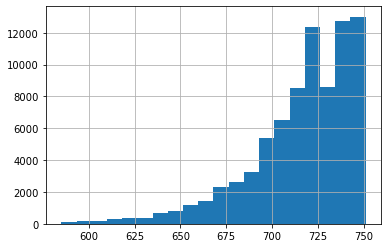

In [18]:

data["CreditScore"].hist(bins=20)

In [19]:
#Removing "Years" from the column to make it numerical  value instead of categorical 
data["Yearsincurrentjob"] = data["Yearsincurrentjob"].str.extract('(\d+)', expand= False)


In [20]:
data.isnull().sum()

LoanID                         514
CustomerID                     514
LoanStatus                     514
CurrentLoanAmount              514
Term                           514
CreditScore                  19668
AnnualIncome                 19668
Yearsincurrentjob             4736
HomeOwnership                  514
Purpose                        514
MonthlyDebt                    514
YearsofCreditHistory           514
Monthssincelastdelinquent    53655
NumberofOpenAccounts           514
NumberofCreditProblems         514
CurrentCreditBalance           514
MaximumOpenCredit              516
Bankruptcies                   718
TaxLiens                       524
dtype: int64

In [21]:
#Working with data that doesnt have nan value for LoanID
data = data[data['LoanID'].notnull()] 

In [22]:
data.isnull().sum()

LoanID                           0
CustomerID                       0
LoanStatus                       0
CurrentLoanAmount                0
Term                             0
CreditScore                  19154
AnnualIncome                 19154
Yearsincurrentjob             4222
HomeOwnership                    0
Purpose                          0
MonthlyDebt                      0
YearsofCreditHistory             0
Monthssincelastdelinquent    53141
NumberofOpenAccounts             0
NumberofCreditProblems           0
CurrentCreditBalance             0
MaximumOpenCredit                2
Bankruptcies                   204
TaxLiens                        10
dtype: int64

In [23]:
#Filling missng value of numerical variable , since all missing value categorical variable went away when dropping missing value of loadID
#Years in current job gave error
data.CreditScore = data.CreditScore.fillna(data.CreditScore.mean())
data.AnnualIncome = data.AnnualIncome.fillna(data.AnnualIncome.mean())
data.Monthssincelastdelinquent = data.Monthssincelastdelinquent.fillna(data.Monthssincelastdelinquent.mean())
data.Bankruptcies = data.Bankruptcies.fillna(data.Bankruptcies.mean())
data.MaximumOpenCredit = data.MaximumOpenCredit.fillna(data.MaximumOpenCredit.mean())
data.TaxLiens = data.TaxLiens.fillna(data.TaxLiens.mean())

In [24]:
data.isnull().sum()

LoanID                          0
CustomerID                      0
LoanStatus                      0
CurrentLoanAmount               0
Term                            0
CreditScore                     0
AnnualIncome                    0
Yearsincurrentjob            4222
HomeOwnership                   0
Purpose                         0
MonthlyDebt                     0
YearsofCreditHistory            0
Monthssincelastdelinquent       0
NumberofOpenAccounts            0
NumberofCreditProblems          0
CurrentCreditBalance            0
MaximumOpenCredit               0
Bankruptcies                    0
TaxLiens                        0
dtype: int64

In [25]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 100000 entries, 0 to 99999
Data columns (total 19 columns):
 #   Column                     Non-Null Count   Dtype  
---  ------                     --------------   -----  
 0   LoanID                     100000 non-null  object 
 1   CustomerID                 100000 non-null  object 
 2   LoanStatus                 100000 non-null  object 
 3   CurrentLoanAmount          100000 non-null  float64
 4   Term                       100000 non-null  object 
 5   CreditScore                100000 non-null  float64
 6   AnnualIncome               100000 non-null  float64
 7   Yearsincurrentjob          95778 non-null   object 
 8   HomeOwnership              100000 non-null  object 
 9   Purpose                    100000 non-null  object 
 10  MonthlyDebt                100000 non-null  float64
 11  YearsofCreditHistory       100000 non-null  float64
 12  Monthssincelastdelinquent  100000 non-null  float64
 13  NumberofOpenAccounts       100

In [26]:
#Converting data type to float to get the mean value and fill the missng value with it. 
data['Yearsincurrentjob'] = data['Yearsincurrentjob'].astype(float, errors = 'raise')

In [27]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 100000 entries, 0 to 99999
Data columns (total 19 columns):
 #   Column                     Non-Null Count   Dtype  
---  ------                     --------------   -----  
 0   LoanID                     100000 non-null  object 
 1   CustomerID                 100000 non-null  object 
 2   LoanStatus                 100000 non-null  object 
 3   CurrentLoanAmount          100000 non-null  float64
 4   Term                       100000 non-null  object 
 5   CreditScore                100000 non-null  float64
 6   AnnualIncome               100000 non-null  float64
 7   Yearsincurrentjob          95778 non-null   float64
 8   HomeOwnership              100000 non-null  object 
 9   Purpose                    100000 non-null  object 
 10  MonthlyDebt                100000 non-null  float64
 11  YearsofCreditHistory       100000 non-null  float64
 12  Monthssincelastdelinquent  100000 non-null  float64
 13  NumberofOpenAccounts       100

In [28]:
#Filling missing value of Year in current job. 
data.Yearsincurrentjob = data.Yearsincurrentjob.fillna(data.Yearsincurrentjob.mean())

In [29]:
data.isnull().sum()

LoanID                       0
CustomerID                   0
LoanStatus                   0
CurrentLoanAmount            0
Term                         0
CreditScore                  0
AnnualIncome                 0
Yearsincurrentjob            0
HomeOwnership                0
Purpose                      0
MonthlyDebt                  0
YearsofCreditHistory         0
Monthssincelastdelinquent    0
NumberofOpenAccounts         0
NumberofCreditProblems       0
CurrentCreditBalance         0
MaximumOpenCredit            0
Bankruptcies                 0
TaxLiens                     0
dtype: int64

In [30]:
data.describe()

,CurrentLoanAmount,CreditScore,AnnualIncome,Yearsincurrentjob,MonthlyDebt,YearsofCreditHistory,Monthssincelastdelinquent,NumberofOpenAccounts,NumberofCreditProblems,CurrentCreditBalance,MaximumOpenCredit,Bankruptcies,TaxLiens
count,1.000000e+05,100000.000000,1.000000e+05,100000.000000,100000.000000,100000.000000,100000.000000,100000.00000,100000.000000,1.000000e+05,1.000000e+05,100000.000000,100000.000000
mean,1.176045e+07,716.293447,1.378277e+06,5.977594,18472.412336,18.199141,34.901321,11.12853,0.168310,2.946374e+05,7.607984e+05,0.117740,0.029313
std,3.178394e+07,25.443196,9.722974e+05,3.426403,12174.992609,7.015324,15.058228,5.00987,0.482705,3.761709e+05,8.384420e+06,0.351065,0.258170
min,1.080200e+04,585.000000,7.662700e+04,1.000000,0.000000,3.600000,0.000000,0.00000,0.000000,0.000000e+00,0.000000e+00,0.000000,0.000000
25%,1.796520e+05,709.000000,9.311805e+05,3.000000,10214.162500,13.500000,34.000000,8.00000,0.000000,1.126700e+05,2.734380e+05,0.000000,0.000000
50%,3.122460e+05,716.293447,1.369919e+06,6.000000,16220.300000,16.900000,34.901321,10.00000,0.000000,2.098170e+05,4.678850e+05,0.000000,0.000000
75%,5.249420e+05,735.000000,1.512704e+06,10.000000,24012.057500,21.700000,34.901321,14.00000,0.000000,3.679588e+05,7.829580e+05,0.000000,0.000000
max,1.000000e+08,751.000000,1.655574e+08,10.000000,435843.280000,70.500000,176.000000,76.00000,15.000000,3.287897e+07,1.539738e+09,7.000000,15.000000


In [31]:
data.head()

,LoanID,CustomerID,LoanStatus,CurrentLoanAmount,Term,CreditScore,AnnualIncome,Yearsincurrentjob,HomeOwnership,Purpose,MonthlyDebt,YearsofCreditHistory,Monthssincelastdelinquent,NumberofOpenAccounts,NumberofCreditProblems,CurrentCreditBalance,MaximumOpenCredit,Bankruptcies,TaxLiens
0,14dd8831-6af5-400b-83ec-68e61888a048,981165ec-3274-42f5-a3b4-d104041a9ca9,Fully Paid,445412.0,Short Term,709.000000,1.167493e+06,8.0,Home Mortgage,Home Improvements,5214.74,17.2,34.901321,6.0,1.0,228190.0,416746.0,1.0,0.0
1,4771cc26-131a-45db-b5aa-537ea4ba5342,2de017a3-2e01-49cb-a581-08169e83be29,Fully Paid,262328.0,Short Term,716.293447,1.378277e+06,10.0,Home Mortgage,Debt Consolidation,33295.98,21.1,8.000000,35.0,0.0,229976.0,850784.0,0.0,0.0
2,4eed4e6a-aa2f-4c91-8651-ce984ee8fb26,5efb2b2b-bf11-4dfd-a572-3761a2694725,Fully Paid,99999999.0,Short Term,741.000000,2.231892e+06,8.0,Own Home,Debt Consolidation,29200.53,14.9,29.000000,18.0,1.0,297996.0,750090.0,0.0,0.0
3,77598f7b-32e7-4e3b-a6e5-06ba0d98fe8a,e777faab-98ae-45af-9a86-7ce5b33b1011,Fully Paid,347666.0,Long Term,721.000000,8.069490e+05,3.0,Own Home,Debt Consolidation,8741.90,12.0,34.901321,9.0,0.0,256329.0,386958.0,0.0,0.0
4,d4062e70-befa-4995-8643-a0de73938182,81536ad9-5ccf-4eb8-befb-47a4d608658e,Fully Paid,176220.0,Short Term,716.293447,1.378277e+06,5.0,Rent,Debt Consolidation,20639.70,6.1,34.901321,15.0,0.0,253460.0,427174.0,0.0,0.0


<AxesSubplot:>

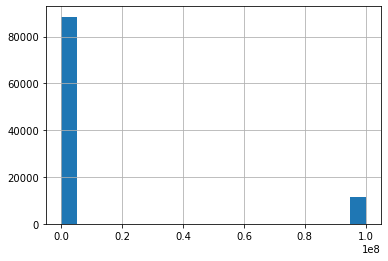

In [32]:
data["CurrentLoanAmount"].hist(bins=20)

<AxesSubplot:>

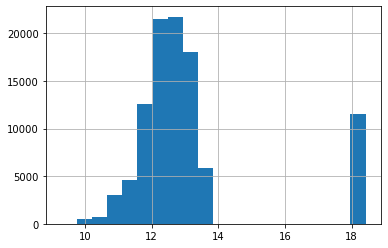

In [33]:
data["CurrentLoanAmount"]= np.log(data["CurrentLoanAmount"])
data["CurrentLoanAmount"].hist(bins=20)

<AxesSubplot:>

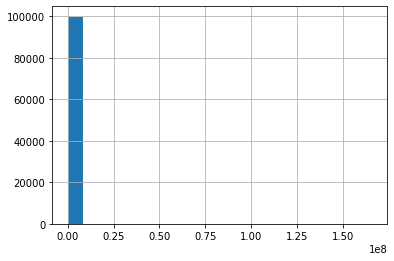

In [34]:
data["AnnualIncome"].hist(bins=20)

<AxesSubplot:>

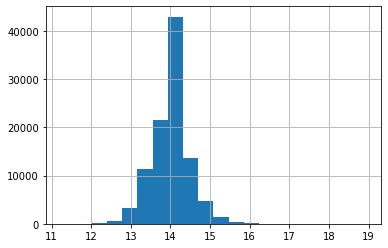

In [35]:
#Normalizing
data["AnnualIncome_log"]= np.log(data["AnnualIncome"])
data["AnnualIncome_log"].hist(bins=20)

<AxesSubplot:>

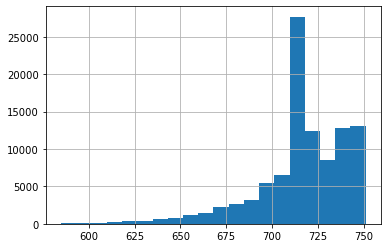

In [36]:
data["CreditScore"].hist(bins=20)

<AxesSubplot:>

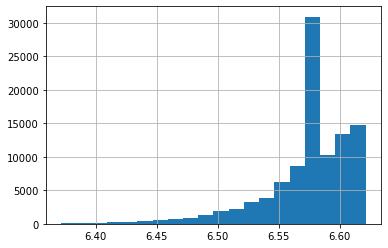

In [37]:
data["CreditScore_log"]= np.log(data["CreditScore"])
data["CreditScore_log"].hist(bins=20)

In [38]:
pd.crosstab(data['AnnualIncome'], data['LoanStatus'], margins =True)

LoanStatus,Charged Off,Fully Paid,All
AnnualIncome,,,
76627.0,1,0,1
81092.0,0,1,1
94867.0,0,1,1
97033.0,0,1,1
106533.0,0,1,1
...,...,...,...
28095300.0,0,1,1
30838995.0,1,0,1
36475440.0,0,1,1


In [39]:
data.describe()

,CurrentLoanAmount,CreditScore,AnnualIncome,Yearsincurrentjob,MonthlyDebt,YearsofCreditHistory,Monthssincelastdelinquent,NumberofOpenAccounts,NumberofCreditProblems,CurrentCreditBalance,MaximumOpenCredit,Bankruptcies,TaxLiens,AnnualIncome_log,CreditScore_log
count,100000.000000,100000.000000,1.000000e+05,100000.000000,100000.000000,100000.000000,100000.000000,100000.00000,100000.000000,1.000000e+05,1.000000e+05,100000.000000,100000.000000,100000.000000,100000.000000
mean,13.132883,716.293447,1.378277e+06,5.977594,18472.412336,18.199141,34.901321,11.12853,0.168310,2.946374e+05,7.607984e+05,0.117740,0.029313,14.018523,6.573434
std,2.012226,25.443196,9.722974e+05,3.426403,12174.992609,7.015324,15.058228,5.00987,0.482705,3.761709e+05,8.384420e+06,0.351065,0.258170,0.474296,0.036581
min,9.287487,585.000000,7.662700e+04,1.000000,0.000000,3.600000,0.000000,0.00000,0.000000,0.000000e+00,0.000000e+00,0.000000,0.000000,11.246705,6.371612
25%,12.098777,709.000000,9.311805e+05,3.000000,10214.162500,13.500000,34.000000,8.00000,0.000000,1.126700e+05,2.734380e+05,0.000000,0.000000,13.744208,6.563856
50%,12.651547,716.293447,1.369919e+06,6.000000,16220.300000,16.900000,34.901321,10.00000,0.000000,2.098170e+05,4.678850e+05,0.000000,0.000000,14.130262,6.574090
75%,13.171043,735.000000,1.512704e+06,10.000000,24012.057500,21.700000,34.901321,14.00000,0.000000,3.679588e+05,7.829580e+05,0.000000,0.000000,14.229409,6.599870
max,18.420681,751.000000,1.655574e+08,10.000000,435843.280000,70.500000,176.000000,76.00000,15.000000,3.287897e+07,1.539738e+09,7.000000,15.000000,18.924828,6.621406


In [40]:
data["LoanStatus"] = data['LoanStatus'].replace(['Fully Paid', 'Charged Off'], ['Y', 'N'])

In [41]:
pd.crosstab(data['AnnualIncome'], data['LoanStatus'], margins =True)

LoanStatus,N,Y,All
AnnualIncome,,,
76627.0,1,0,1
81092.0,0,1,1
94867.0,0,1,1
97033.0,0,1,1
106533.0,0,1,1
...,...,...,...
28095300.0,0,1,1
30838995.0,1,0,1
36475440.0,0,1,1


In [42]:
data.head()

,LoanID,CustomerID,LoanStatus,CurrentLoanAmount,Term,CreditScore,AnnualIncome,Yearsincurrentjob,HomeOwnership,Purpose,...,YearsofCreditHistory,Monthssincelastdelinquent,NumberofOpenAccounts,NumberofCreditProblems,CurrentCreditBalance,MaximumOpenCredit,Bankruptcies,TaxLiens,AnnualIncome_log,CreditScore_log
0,14dd8831-6af5-400b-83ec-68e61888a048,981165ec-3274-42f5-a3b4-d104041a9ca9,Y,13.006755,Short Term,709.000000,1.167493e+06,8.0,Home Mortgage,Home Improvements,...,17.2,34.901321,6.0,1.0,228190.0,416746.0,1.0,0.0,13.970369,6.563856
1,4771cc26-131a-45db-b5aa-537ea4ba5342,2de017a3-2e01-49cb-a581-08169e83be29,Y,12.477351,Short Term,716.293447,1.378277e+06,10.0,Home Mortgage,Debt Consolidation,...,21.1,8.000000,35.0,0.0,229976.0,850784.0,0.0,0.0,14.136344,6.574090
2,4eed4e6a-aa2f-4c91-8651-ce984ee8fb26,5efb2b2b-bf11-4dfd-a572-3761a2694725,Y,18.420681,Short Term,741.000000,2.231892e+06,8.0,Own Home,Debt Consolidation,...,14.9,29.000000,18.0,1.0,297996.0,750090.0,0.0,0.0,14.618360,6.608001
3,77598f7b-32e7-4e3b-a6e5-06ba0d98fe8a,e777faab-98ae-45af-9a86-7ce5b33b1011,Y,12.758998,Long Term,721.000000,8.069490e+05,3.0,Own Home,Debt Consolidation,...,12.0,34.901321,9.0,0.0,256329.0,386958.0,0.0,0.0,13.601016,6.580639
4,d4062e70-befa-4995-8643-a0de73938182,81536ad9-5ccf-4eb8-befb-47a4d608658e,Y,12.079488,Short Term,716.293447,1.378277e+06,5.0,Rent,Debt Consolidation,...,6.1,34.901321,15.0,0.0,253460.0,427174.0,0.0,0.0,14.136344,6.574090


In [43]:
#Filtering independent and dependent variable 
X = data.iloc[:,np.r_[3:19]].values #independent variable
Y = data.iloc[:,2].values #dependent variable

In [44]:
X

array([[13.006754975517012, 'Short Term', 709.0, 1167493.0, 8.0,
        'Home Mortgage', 'Home Improvements', 5214.74, 17.2,
        34.90132098422929, 6.0, 1.0, 228190.0, 416746.0, 1.0, 0.0],
       [12.477350908156279, 'Short Term', 716.2934468000891,
        1378276.559842169, 10.0, 'Home Mortgage', 'Debt Consolidation',
        33295.98, 21.1, 8.0, 35.0, 0.0, 229976.0, 850784.0, 0.0, 0.0],
       [18.420680733952366, 'Short Term', 741.0, 2231892.0, 8.0,
        'Own Home', 'Debt Consolidation', 29200.53, 14.9, 29.0, 18.0,
        1.0, 297996.0, 750090.0, 0.0, 0.0],
       [12.75899752776742, 'Long Term', 721.0, 806949.0, 3.0, 'Own Home',
        'Debt Consolidation', 8741.9, 12.0, 34.90132098422929, 9.0, 0.0,
        256329.0, 386958.0, 0.0, 0.0],
       [12.07948849342072, 'Short Term', 716.2934468000891,
        1378276.559842169, 5.0, 'Rent', 'Debt Consolidation', 20639.7,
        6.1, 34.90132098422929, 15.0, 0.0, 253460.0, 427174.0, 0.0, 0.0],
       [12.23854951616293, 'Shor

In [45]:
Y

array(['Y', 'Y', 'Y', 'Y', 'Y', 'N', 'Y', 'N', 'Y', 'Y', 'Y', 'Y', 'Y',
       'Y', 'Y', 'Y', 'N', 'Y', 'Y', 'Y', 'N', 'Y', 'N', 'Y', 'Y', 'Y',
       'Y', 'Y', 'Y', 'Y', 'Y', 'Y', 'N', 'Y', 'Y', 'Y', 'Y', 'Y', 'N',
       'Y', 'N', 'Y', 'Y', 'N', 'Y', 'Y', 'Y', 'Y', 'Y', 'N', 'Y', 'N',
       'N', 'N', 'Y', 'N', 'N', 'Y', 'Y', 'Y', 'N', 'Y', 'Y', 'Y', 'Y',
       'N', 'Y', 'N', 'Y', 'Y', 'Y', 'Y', 'Y', 'Y', 'Y', 'N', 'Y', 'Y',
       'Y', 'Y', 'Y', 'Y', 'Y', 'Y', 'Y', 'Y', 'Y', 'Y', 'N', 'Y', 'Y',
       'Y', 'Y', 'Y', 'Y', 'Y', 'Y', 'N', 'Y', 'Y', 'Y', 'Y', 'N', 'Y',
       'Y', 'Y', 'N', 'Y', 'Y', 'Y', 'N', 'N', 'N', 'Y', 'Y', 'Y', 'Y',
       'N', 'N', 'Y', 'Y', 'Y', 'Y', 'N', 'Y', 'N', 'Y', 'Y', 'Y', 'Y',
       'Y', 'Y', 'Y', 'Y', 'N', 'Y', 'Y', 'Y', 'N', 'Y', 'N', 'Y', 'Y',
       'Y', 'Y', 'Y', 'Y', 'Y', 'Y', 'Y', 'Y', 'Y', 'N', 'Y', 'Y', 'Y',
       'N', 'Y', 'Y', 'Y', 'N', 'N', 'Y', 'Y', 'Y', 'N', 'Y', 'Y', 'Y',
       'Y', 'Y', 'Y', 'Y', 'Y', 'N', 'Y', 'N', 'Y', 'Y', 'Y', 'Y

In [46]:
X_train, X_test, Y_train, Y_test = train_test_split(X,Y, test_size=0.2, random_state=0)

In [47]:
print(X_train)

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [48]:
#Using label encoder to change catagorical format into numeric format
from sklearn.preprocessing import LabelEncoder
labelencoder_X = LabelEncoder()

In [49]:
for i in range(0,15):
    X_train[:,i] = labelencoder_X.fit_transform(X_train[:,i])

In [50]:
X_train

array([[74, 1, 157, 7579, 4, 3, 3, 24704, 219, 25, 22, 0, 6785, 26170, 0,
        0.0],
       [17043, 0, 138, 25316, 0, 1, 11, 7812, 84, 35, 16, 0, 993, 21127,
        0, 0.0],
       [16070, 0, 136, 20665, 3, 3, 3, 46048, 146, 34, 13, 0, 27123,
        30917, 0, 0.0],
       [10676, 0, 122, 4377, 1, 1, 3, 25203, 288, 13, 31, 1, 10803,
        34766, 2, 0.0],
       [10946, 1, 132, 18293, 9, 1, 3, 40859, 78, 24, 11, 2, 8354, 8679,
        0, 1.0],
       [20185, 0, 104, 23711, 10, 3, 3, 48474, 163, 35, 11, 0, 27884,
        35160, 0, 0.0],
       [1090, 1, 143, 8704, 5, 3, 3, 42037, 369, 35, 16, 0, 15278, 18849,
        0, 0.0],
       [15438, 1, 132, 18293, 0, 1, 3, 54364, 143, 56, 25, 0, 27170,
        35383, 0, 0.0],
       [2511, 1, 147, 3986, 2, 2, 2, 14240, 219, 29, 5, 0, 4507, 5150, 0,
        0.0],
       [20652, 1, 154, 1349, 0, 3, 3, 8676, 204, 32, 12, 0, 7326, 30315,
        0, 0.0],
       [11490, 0, 132, 18293, 2, 2, 3, 29548, 74, 35, 11, 1, 13548,
        17130, 0, 1.0],

In [51]:
labelencoder_Y = LabelEncoder()
Y_train = labelencoder_Y.fit_transform(Y_train)

In [52]:
Y_train

array([1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1,
       1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0,
       1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1,
       1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1,
       0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1,
       0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1,
       1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1,
       0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1,
       1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0,
       1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1,
       1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1,

In [53]:
for i in range(0,15):
    X_test[:,i] = labelencoder_X.fit_transform(X_test[:,i])

In [54]:
X_test

array([[4834, 1, 136, 10293, 4, 1, 3, 11837, 71, 11, 8, 0, 4559, 2714, 0,
        0.0],
       [10904, 1, 150, 4928, 0, 1, 1, 8186, 81, 35, 12, 0, 7176, 12058,
        0, 0.0],
       [3726, 1, 108, 6843, 7, 3, 3, 4526, 181, 40, 19, 0, 7461, 10306,
        0, 0.0],
       [10904, 1, 163, 991, 7, 3, 3, 2268, 121, 35, 7, 0, 5585, 5008, 0,
        0.0],
       [4775, 1, 153, 5758, 7, 3, 3, 10320, 136, 35, 11, 0, 4276, 7337,
        0, 0.0],
       [3465, 1, 109, 2619, 10, 3, 3, 821, 102, 69, 6, 0, 2271, 1151, 0,
        0.0],
       [5954, 0, 136, 6501, 0, 3, 3, 3403, 120, 9, 13, 0, 7674, 8221, 0,
        0.0],
       [3842, 1, 159, 3341, 1, 2, 3, 10692, 60, 35, 15, 0, 6484, 10158,
        0, 0.0],
       [5081, 1, 132, 7658, 3, 1, 3, 6199, 235, 35, 6, 1, 11388, 9979, 2,
        0.0],
       [10904, 1, 166, 3625, 6, 3, 3, 8137, 73, 35, 8, 0, 4516, 5338, 0,
        0.0],
       [3323, 1, 163, 5029, 4, 2, 3, 12091, 124, 35, 18, 0, 5403, 15013,
        0, 0.0],
       [10095, 1, 153, 9637, 6

In [55]:
labelencoder_Y = LabelEncoder()
Y_test = labelencoder_Y.fit_transform(Y_test)

In [56]:
Y_test

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0,
       1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1,
       0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1,
       0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1,
       1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1,
       1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0,
       1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1,
       1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0,
       0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1,
       0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1,

In [57]:
ss= StandardScaler()
X_train=ss.fit_transform(X_train)
X_test=ss.fit_transform(X_test)

In [58]:
from sklearn.tree import DecisionTreeClassifier
DTClassifier = DecisionTreeClassifier(criterion="entropy", random_state=0)
DTClassifier.fit(X_train,Y_train)

DecisionTreeClassifier(criterion='entropy', random_state=0)

In [59]:
y_pred= DTClassifier.predict(X_test)
y_pred

array([1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1,
       0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1,
       1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1,
       1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0,
       0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1,
       1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1,
       1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1,
       1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1,
       1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1,
       0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1,
       1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1,
       1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0,

In [60]:
from sklearn import metrics
print("The acccuracy of decision tree is: ", metrics.accuracy_score(y_pred,Y_test))

The acccuracy of decision tree is:  0.65455


In [61]:
from sklearn.naive_bayes import GaussianNB
NBClassifier = GaussianNB()
NBClassifier.fit(X_train, Y_train)

GaussianNB()

In [62]:
y_pred = NBClassifier.predict(X_test)

In [63]:
y_pred

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1,
       1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1,

In [64]:
print("The accuracy of Naive Bayes is:", metrics.accuracy_score(y_pred,Y_test))

The accuracy of Naive Bayes is: 0.7598


In [65]:
testdata = pd.read_csv("credit_test.csv")

In [66]:
testdata.head()

,Loan ID,Customer ID,Current Loan Amount,Term,Credit Score,Annual Income,Years in current job,Home Ownership,Purpose,Monthly Debt,Years of Credit History,Months since last delinquent,Number of Open Accounts,Number of Credit Problems,Current Credit Balance,Maximum Open Credit,Bankruptcies,Tax Liens
0,f738779f-c726-40dc-92cf-689d73af533d,ded0b3c3-6bf4-4091-8726-47039f2c1b90,611314.0,Short Term,747.0,2074116.0,10+ years,Home Mortgage,Debt Consolidation,42000.83,21.8,NaN,9.0,0.0,621908.0,1058970.0,0.0,0.0
1,6dcc0947-164d-476c-a1de-3ae7283dde0a,1630e6e3-34e3-461a-8fda-09297d3140c8,266662.0,Short Term,734.0,1919190.0,10+ years,Home Mortgage,Debt Consolidation,36624.40,19.4,NaN,11.0,0.0,679573.0,904442.0,0.0,0.0
2,f7744d01-894b-49c3-8777-fc6431a2cff1,2c60938b-ad2b-4702-804d-eeca43949c52,153494.0,Short Term,709.0,871112.0,2 years,Rent,Debt Consolidation,8391.73,12.5,10.0,10.0,0.0,38532.0,388036.0,0.0,0.0
3,83721ffb-b99a-4a0f-aea5-ef472a138b41,12116614-2f3c-4d16-ad34-d92883718806,176242.0,Short Term,727.0,780083.0,10+ years,Rent,Debt Consolidation,16771.87,16.5,27.0,16.0,1.0,156940.0,531322.0,1.0,0.0
4,08f3789f-5714-4b10-929d-e1527ab5e5a3,39888105-fd5f-4023-860a-30a3e6f5ccb7,321992.0,Short Term,744.0,1761148.0,10+ years,Home Mortgage,Debt Consolidation,39478.77,26.0,44.0,14.0,0.0,359765.0,468072.0,0.0,0.0


In [67]:
testdata.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10353 entries, 0 to 10352
Data columns (total 18 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Loan ID                       10000 non-null  object 
 1   Customer ID                   10000 non-null  object 
 2   Current Loan Amount           10000 non-null  float64
 3   Term                          10000 non-null  object 
 4   Credit Score                  8019 non-null   float64
 5   Annual Income                 8019 non-null   float64
 6   Years in current job          9573 non-null   object 
 7   Home Ownership                10000 non-null  object 
 8   Purpose                       10000 non-null  object 
 9   Monthly Debt                  10000 non-null  float64
 10  Years of Credit History       10000 non-null  float64
 11  Months since last delinquent  4694 non-null   float64
 12  Number of Open Accounts       10000 non-null  float64
 13  N

In [68]:
testdata.isnull().sum()

Loan ID                          353
Customer ID                      353
Current Loan Amount              353
Term                             353
Credit Score                    2334
Annual Income                   2334
Years in current job             780
Home Ownership                   353
Purpose                          353
Monthly Debt                     353
Years of Credit History          353
Months since last delinquent    5659
Number of Open Accounts          353
Number of Credit Problems        353
Current Credit Balance           353
Maximum Open Credit              353
Bankruptcies                     375
Tax Liens                        354
dtype: int64

In [69]:
testdata.columns = testdata.columns.str.replace(' ', '') #Removing white space so it would be easier to execute code 


In [70]:
testdata = testdata[testdata['LoanID'].notnull()] 

In [71]:
testdata.isnull().sum()

LoanID                          0
CustomerID                      0
CurrentLoanAmount               0
Term                            0
CreditScore                  1981
AnnualIncome                 1981
Yearsincurrentjob             427
HomeOwnership                   0
Purpose                         0
MonthlyDebt                     0
YearsofCreditHistory            0
Monthssincelastdelinquent    5306
NumberofOpenAccounts            0
NumberofCreditProblems          0
CurrentCreditBalance            0
MaximumOpenCredit               0
Bankruptcies                   22
TaxLiens                        1
dtype: int64

In [72]:
testdata = testdata[testdata['TaxLiens'].notnull()] 

In [73]:
testdata = testdata[testdata['Bankruptcies'].notnull()] 
testdata = testdata[testdata['Yearsincurrentjob'].notnull()] 

In [74]:
testdata.isnull().sum()

LoanID                          0
CustomerID                      0
CurrentLoanAmount               0
Term                            0
CreditScore                  1893
AnnualIncome                 1893
Yearsincurrentjob               0
HomeOwnership                   0
Purpose                         0
MonthlyDebt                     0
YearsofCreditHistory            0
Monthssincelastdelinquent    5079
NumberofOpenAccounts            0
NumberofCreditProblems          0
CurrentCreditBalance            0
MaximumOpenCredit               0
Bankruptcies                    0
TaxLiens                        0
dtype: int64

In [75]:
testdata.CreditScore = testdata.CreditScore.fillna(testdata.CreditScore.mean())
testdata.AnnualIncome = testdata.AnnualIncome.fillna(testdata.AnnualIncome.mean())
testdata.Monthssincelastdelinquent = testdata.Monthssincelastdelinquent.fillna(testdata.Monthssincelastdelinquent.mean())

In [76]:
testdata.isnull().sum()

LoanID                       0
CustomerID                   0
CurrentLoanAmount            0
Term                         0
CreditScore                  0
AnnualIncome                 0
Yearsincurrentjob            0
HomeOwnership                0
Purpose                      0
MonthlyDebt                  0
YearsofCreditHistory         0
Monthssincelastdelinquent    0
NumberofOpenAccounts         0
NumberofCreditProblems       0
CurrentCreditBalance         0
MaximumOpenCredit            0
Bankruptcies                 0
TaxLiens                     0
dtype: int64

<AxesSubplot:>

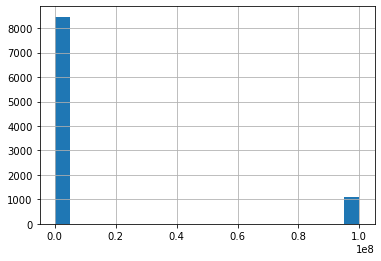

In [77]:
testdata["CurrentLoanAmount"].hist(bins=20)


In [78]:
testdata["CurrentLoanAmount_log"] = np.log(testdata["CurrentLoanAmount"])

<AxesSubplot:>

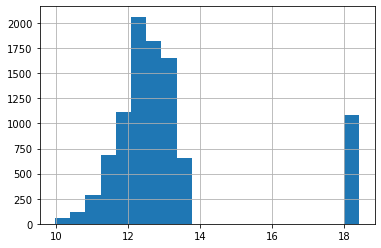

In [79]:
testdata["CurrentLoanAmount_log"].hist(bins=20)

<AxesSubplot:>

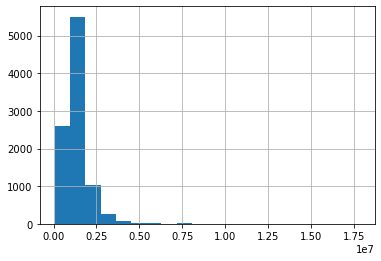

In [80]:
testdata["AnnualIncome"].hist(bins=20)

<AxesSubplot:>

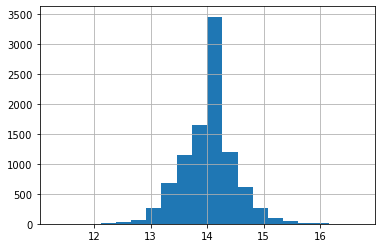

In [81]:
testdata["AnnualIncome_log"] = np.log(testdata["AnnualIncome"])
testdata["AnnualIncome_log"].hist(bins=20)

<AxesSubplot:>

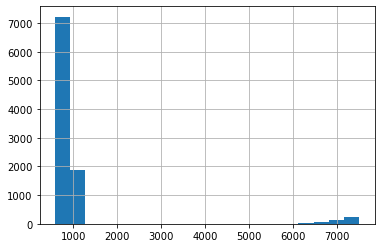

In [82]:
testdata["CreditScore"].hist(bins=20)

In [83]:
testdata.describe()

,CurrentLoanAmount,CreditScore,AnnualIncome,MonthlyDebt,YearsofCreditHistory,Monthssincelastdelinquent,NumberofOpenAccounts,NumberofCreditProblems,CurrentCreditBalance,MaximumOpenCredit,Bankruptcies,TaxLiens,CurrentLoanAmount_log,AnnualIncome_log
count,9.551000e+03,9551.000000,9.551000e+03,9551.000000,9551.000000,9551.000000,9551.000000,9551.00000,9.551000e+03,9.551000e+03,9551.000000,9551.000000,9551.000000,9551.000000
mean,1.161626e+07,1079.829982,1.387575e+06,18676.689905,18.011936,35.059705,11.134960,0.16103,2.930906e+05,6.876797e+05,0.112030,0.030468,13.128816,14.031410
std,3.161007e+07,1326.039682,7.826704e+05,12474.122433,6.758273,14.796098,5.029453,0.49862,3.914985e+05,1.883311e+06,0.342783,0.289816,1.998747,0.464940
min,2.147200e+04,585.000000,8.109200e+04,0.000000,3.800000,0.000000,1.000000,0.00000,0.000000e+00,0.000000e+00,0.000000,0.000000,9.974505,11.303340
25%,1.820940e+05,712.000000,9.445850e+05,10430.240000,13.500000,34.000000,8.000000,0.00000,1.099340e+05,2.738120e+05,0.000000,0.000000,12.112278,13.758501
50%,3.145780e+05,734.000000,1.387575e+06,16265.710000,16.900000,35.059705,10.000000,0.00000,2.101400e+05,4.652120e+05,0.000000,0.000000,12.658987,14.143068
75%,5.199480e+05,751.000000,1.529196e+06,24147.765000,21.500000,35.059705,14.000000,0.00000,3.658640e+05,7.881280e+05,0.000000,0.000000,13.161484,14.240253
max,1.000000e+08,7510.000000,1.781535e+07,229057.920000,52.500000,131.000000,55.000000,10.00000,1.623744e+07,1.459073e+08,5.000000,9.000000,18.420681,16.695571


In [84]:
#Counting number of credit score more than 850
larger_elements = [element for element in testdata["CreditScore"] if element > 850]
number_of_elements = len(larger_elements)
print(number_of_elements)

2328


In [85]:
#Counting number of credit score more than 850
smaller_elements = [element for element in testdata["CreditScore"] if element < 500]
small_number = len(smaller_elements)
print(small_number)

0


In [86]:
testdata = testdata[testdata["CreditScore"] > 500]
testdata = testdata[testdata["CreditScore"] <=  850]

In [87]:
#Counting number of credit score more than 850
smaller_elements = [element for element in testdata["CreditScore"] if element < 500]
small_number = len(smaller_elements)
print(small_number)

0


In [88]:
#Counting number of credit score more than 850
larger_elements = [element for element in testdata["CreditScore"] if element > 850]
number_of_elements = len(larger_elements)
print(number_of_elements)

0


<AxesSubplot:>

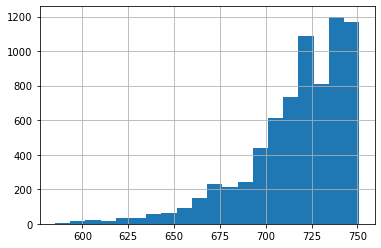

In [89]:
testdata["CreditScore"].hist(bins=20)

In [90]:
testdata["CreditScore_log"] = np.log(testdata["CreditScore"])

<AxesSubplot:>

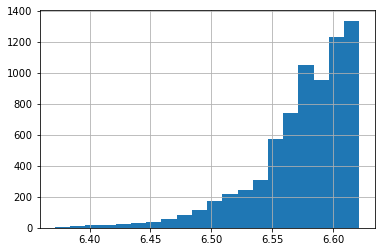

In [91]:
testdata["CreditScore_log"].hist(bins=20)

In [92]:
test = testdata.iloc[:,np.r_[3:19]].values

In [93]:
test

array([['Short Term', 747.0, 2074116.0, '10+ years', 'Home Mortgage',
        'Debt Consolidation', 42000.83, 21.8, 35.05970483005367, 9.0,
        0.0, 621908.0, 1058970.0, 0.0, 0.0, 13.323366017766675],
       ['Short Term', 734.0, 1919190.0, '10+ years', 'Home Mortgage',
        'Debt Consolidation', 36624.4, 19.4, 35.05970483005367, 11.0,
        0.0, 679573.0, 904442.0, 0.0, 0.0, 12.493737217828828],
       ['Short Term', 709.0, 871112.0, '2 years', 'Rent',
        'Debt Consolidation', 8391.73, 12.5, 10.0, 10.0, 0.0, 38532.0,
        388036.0, 0.0, 0.0, 11.941416757297553],
       ['Short Term', 727.0, 780083.0, '10+ years', 'Rent',
        'Debt Consolidation', 16771.87, 16.5, 27.0, 16.0, 1.0, 156940.0,
        531322.0, 1.0, 0.0, 12.079613329573432],
       ['Short Term', 744.0, 1761148.0, '10+ years', 'Home Mortgage',
        'Debt Consolidation', 39478.77, 26.0, 44.0, 14.0, 0.0, 359765.0,
        468072.0, 0.0, 0.0, 12.682281979497413],
       ['Short Term', 741.0, 760380.0, 

In [94]:
for i in range(0,15):
    test[:,i]= labelencoder_X.fit_transform(test[:,i])

In [95]:
test

array([[1, 155, 5581, 1, 1, 3, 6765, 174, 36, 8, 0, 5749, 5734, 0, 0,
        13.323366017766675],
       [1, 142, 5348, 1, 1, 3, 6560, 150, 36, 10, 0, 5878, 5330, 0, 0,
        12.493737217828828],
       [1, 117, 1667, 2, 3, 3, 1233, 81, 10, 9, 0, 367, 2641, 0, 0,
        11.941416757297553],
       [1, 135, 1272, 1, 3, 3, 3634, 121, 27, 15, 1, 2250, 3703, 1, 0,
        12.079613329573432],
       [1, 152, 5016, 1, 1, 3, 6664, 216, 45, 13, 0, 4563, 3280, 0, 0,
        12.682281979497413],
       [1, 149, 1160, 0, 3, 3, 817, 94, 36, 5, 0, 3580, 3341, 0, 0,
        12.22060651530721],
       [0, 141, 5068, 1, 1, 3, 6555, 109, 36, 38, 0, 3841, 6226, 0, 0,
        13.340351261075094],
       [1, 144, 2660, 5, 3, 3, 4157, 161, 36, 1, 0, 0, 0, 0, 0,
        12.218327250197174],
       [0, 91, 5509, 2, 3, 3, 2350, 200, 57, 7, 2, 300, 1398, 2, 0,
        12.492333708826507],
       [1, 131, 3532, 7, 3, 3, 781, 102, 65, 11, 0, 1758, 1545, 0, 0,
        12.461117883455657],
       [1, 88, 281,

In [96]:
test = ss.fit_transform(test)

In [97]:
pred= NBClassifier.predict(test)

In [98]:
pred

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

In [99]:
pred

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,